In [28]:
import rasterio as rio 
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd 
import matplotlib.patches as mpatches 
from matplotlib.colors import ListedColormap
from rasterio.enums import Resampling 
from PIL import ImageColor
from skimage.exposure import rescale_intensity
import json

In [2]:
lc_dir = "lc.json"
lc_image_dir = 'https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/LC_Image_v1.tif'
palsar_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Palsar_Kerinci_2023_v1.tif"
landsat_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Landsat_Kerinci_2023_v1.tif"

In [ ]:
lc = json.load(open(lc_dir))
lc_df = pd.DataFrame(lc)
lc_df["values_normalize"] = lc_df.index +1 
lc_df["palette"] = "#" + lc_df["palette"]

values = lc_df["values"].to_list()
values_norm = lc_df["values_normalize"].to_list()
palette = lc_df["palette"].to_list()
labels = lc_df["label"].to_list()

dict_values = {}
dict_label = {}
dict_palette = {}
dict_palette_hex = {}

for x in range(0,len(values)):
    dict_values[values[x]] = values_norm[x]
    dict_label[values_norm[x]] = labels[x]
    dict_palette[values_norm[x]] = ImageColor.getrgb(palette[x])
    dict_palette_hex[values_norm[x]] = palette[x]
    
## colormap from values and palette
cmap = ListedColormap(palette) ## defines a colormap with our chosen class colors , example ; “Whenever you see value 1, color it #006400 ; value 2, color it #228B22; …”

patches = [ ## creates colored squares for the legend.
    mpatches.Patch(color=palette[i], label=labels[i]) for i in range(len(values))
]    

legend = {
    "handles":patches,
    "bbox_to_anchor":(1.05,1),
    "loc":2,
    "borderaxespad":0.0,
}
lc_df

,palette,values,label,values_normalize
0,#006400,2001,Primary dryland forest,1
1,#228B22,2002,Secondary dryland forest,2
2,#4B0082,2004,Primary mangrove forest,3
3,#808000,2005,Primary swamp forest,4
4,#32CD32,2006,Plantation forest,5
5,#90EE90,2007,Dry shrub,6
6,#FF4500,2010,Estate crop,7
7,#F08080,2012,Settlement,8
8,#D2B48C,2014,Bare ground,9
9,#ADFF2F,3000,Savanna and grasses,10


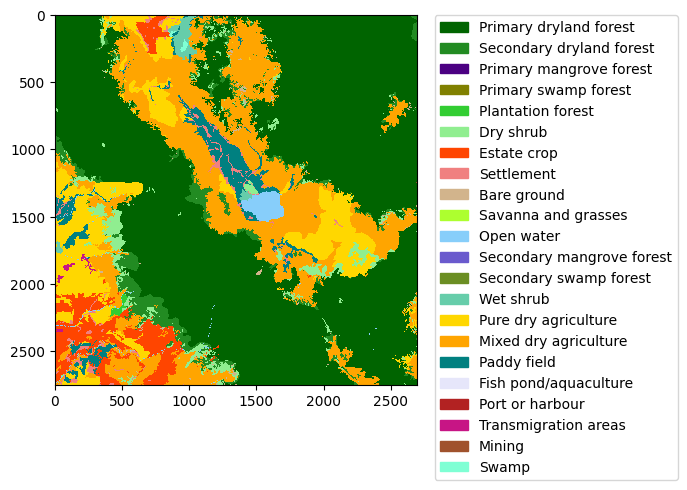

In [ ]:
## Remapping LC image data
""" 
Opens the LC GeoTIFF
Reads the first band (categorical classes).
Replaces original class values with normalized ones (so they align with our colormap).
"""
lc_source = rio.open(lc_image_dir) ## .tif file ,  a categorical raster (each pixel is a class ID, like 0 = water, 1 = forest).
lc_image = lc_source.read()[0] ## read first band ==> categorical land cover values
### lc_image is just a 2D NumPy array. Each number in it represents a class
for x in range(0,len(lc_df)) : 
    lc_dict = lc_df.loc[x]
    lc_image[lc_image == lc_dict["values"]] = lc_dict["values_normalize"]

plt.imshow(lc_image, cmap=cmap,interpolation="nearest",vmin=1,vmax=22)
plt.legend(**legend)

In [ ]:
landsat = rio.open(landsat_dir) ## multi-band Landsat image with reflectance values (continuous data) ==> loads all the bands into 3D array (band, height, width)
landsat_image = landsat.read() / 1e4 ## rescales reflectance

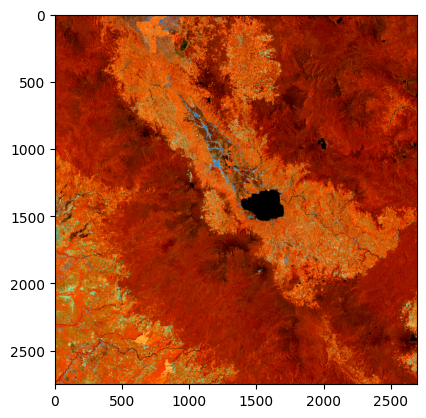

In [ ]:
""" 
==> stacks 3 bands into an RGB image.
Band 5 (NIR, near infrared) → red channel
Band 6 (SWIR1, shortwave infrared) → green channel
Band 7 (SWIR2, shortwave infrared) → blue channel

===> false-color composite <=== (continuous reflectance, shows real “textures” of landscape)

Vegetation reflects strongly in NIR → appears bright red.
Water absorbs NIR → appears very dark.
Urban/bare soil show up in other shades.

rescale_intensity stretches values into [0,1], so the image has contrast.
"""
composite = np.dstack([
    rescale_intensity(landsat_image[4], in_range=(0.125,0.4),out_range=(0,1)),
    rescale_intensity(landsat_image[5], in_range=(0.1,0.3),out_range=(0,1)),
    rescale_intensity(landsat_image[6], in_range=(0.075,0.2),out_range=(0,1)),
])

plt.imshow(composite)

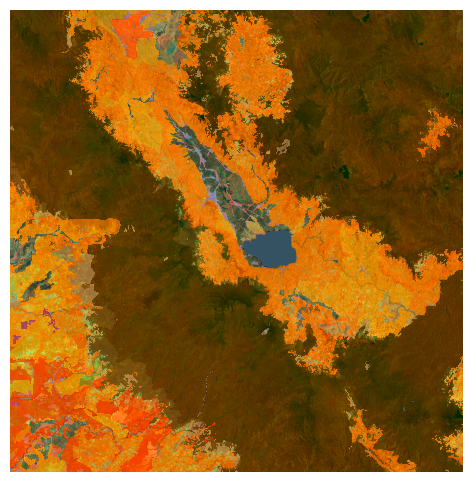

In [24]:
plt.figure(figsize=(6,6))

# Landsat composite (background)
plt.imshow(composite)

# Land cover classification (overlay, semi-transparent)
plt.imshow(lc_image, cmap=cmap, interpolation="nearest", 
           vmin=1, vmax=len(values), alpha=0.4)

# Legend
#plt.legend(handles=patches, bbox_to_anchor=(1.05,1), loc=2, borderaxespad=0.)
plt.axis("off")
plt.show()


In [25]:
uniques = np.unique(lc_image)
uniques

array([ 1,  2,  5,  6,  7,  8,  9, 11, 14, 15, 16, 17, 20, 21, 22],
      dtype=int32)

In [26]:
image_width = 128

image_pre_lc = 20
plt.figure(figsize=(4*image_pre_lc,4*len(uniques))) 

coordds_dict = {}

for x in range(0,len(uniques)):
    ## land cover classes
    lc=uniques[x]
    coords = np.argwhere(lc_image == lc)
    coordds_filter = []
    
    for c in coords : 
        cond1 = (c[0] - (image_width/2)) >=0
        cond2 = (c[1] - (image_width/2)) >=0
        cond3 = (c[0] + (image_width/2)) <= lc_image.shape[0]
        cond4 = (c[1] + (image_width/2)) <= lc_image.shape[1]
        if(cond1 & cond2 & cond3 & cond4):
            coordds_filter.append(c)
    coordds_dict[lc] = []
    if (len(coordds_filter) > 0):
        seq = np.arange(len(coordds_filter)-1)
        sample = np.random.choice(seq,size=image_pre_lc)
        sample_coord = list(map(lambda x: coordds_filter[x], sample))
        
        for y in range(0,len(sample_coord)):
            coord = sample_coord[y]
            max_y = int(coord[0] + (image_width/2))
            min_y = int(coord[0] - (image_width/2))
            max_x = int(coord[1] + (image_width/2))
            min_x = int(coord[1] - (image_width/2))
            
            coordds_dict[lc].append([
                min_y,
                max_y,
                min_x,
                max_x
            ])
        


<Figure size 8000x6000 with 0 Axes>

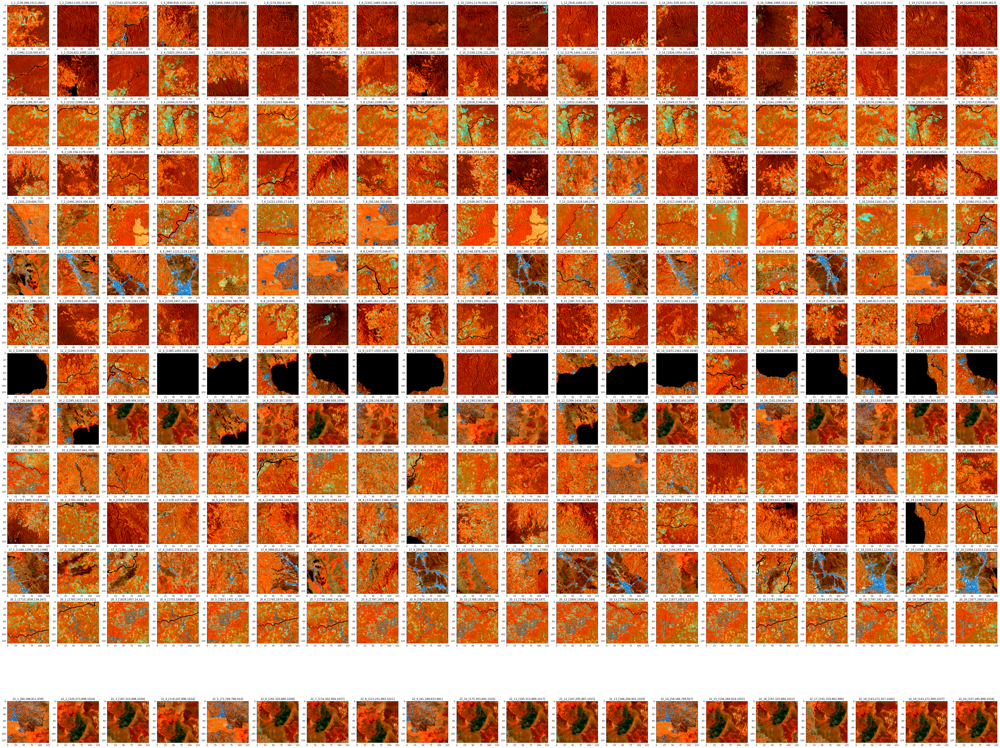

In [32]:
plt.figure(figsize=(4*image_pre_lc, 4*len(uniques)))

for x in range(0,len(uniques)) : 
    lc=uniques[x]
    coords_list = coordds_dict[lc]
    
    for y in range(0,len(coords_list)):
        min_y,max_y,min_x,max_x = coords_list[y]
        image_coord = composite[min_y:max_y,min_x:max_x]
        image_coord_t = np.transpose(image_coord,(2,0,1))
        id = f"{lc}_{y+1}"
        window = rio.windows.Window.from_slices((min_y,max_y),(min_x,max_x))
        transform = landsat.window_transform(window)
        output = rio.open(
            f"C://Users//DHIA//Desktop//Satellite Imagery Land Cover Classification//data//images//{id}.tif",
            "w",
            'COG',
            count=image_coord_t.shape[0],
            width=image_coord_t.shape[2],
            height=image_coord_t.shape[1],
            dtype="float32",
            compress="lzw",
            resampling=Resampling.nearest,
            transform=transform,
            crs=landsat.crs
        )
        output.write(image_coord_t)
        output.close()
        
        plt.subplot(len(uniques),image_pre_lc,x*(image_pre_lc)+y+1)
        plt.imshow(image_coord)
        plt.title(f"{lc}_{y+1}_[{min_y},{max_y},{min_x},{max_x}]")        

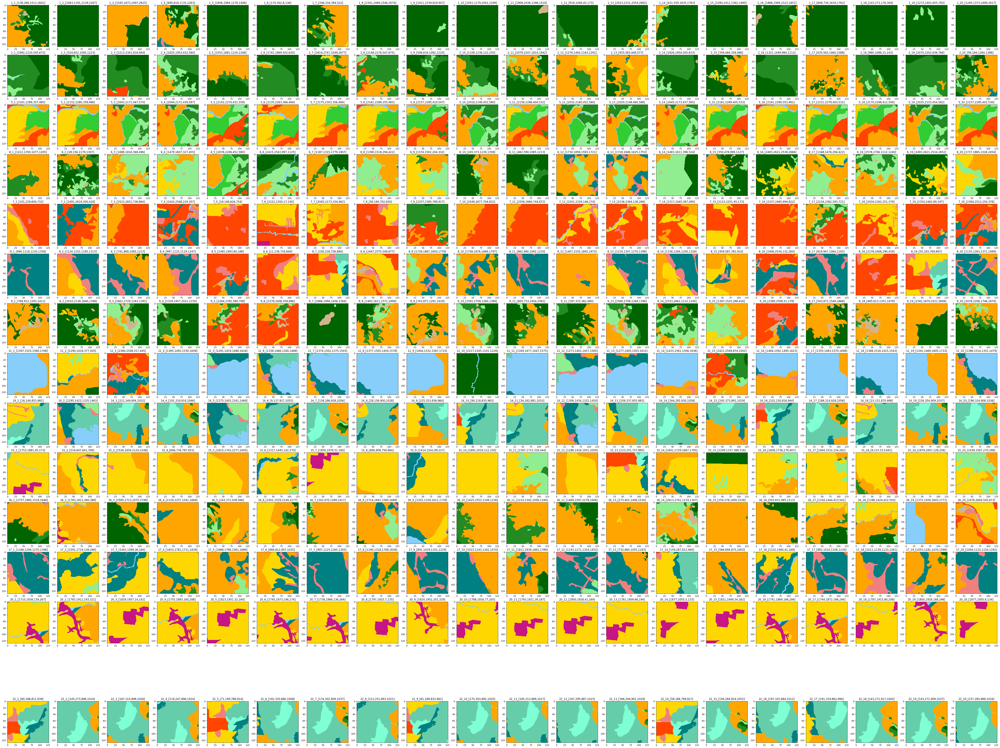

In [40]:
plt.figure(figsize=(4*image_pre_lc, 4*len(uniques)))

for x in range(0,len(uniques)) : 
    lc=uniques[x]
    coords_list = coordds_dict[lc]
    
    for y in range(0,len(coords_list)):
        min_y,max_y,min_x,max_x = coords_list[y]
        
        lc_coord = lc_image[min_y:max_y,min_x:max_x]

        id = f"{lc}_{y+1}"
        window = rio.windows.Window.from_slices((min_y,max_y),(min_x,max_x))
        transform = landsat.window_transform(window)
        output = rio.open(
            f"C://Users//DHIA//Desktop//Satellite Imagery Land Cover Classification//data//lcs//{id}.tif",
            "w",
            'COG',
            count=1,
            width=lc_coord.shape[1],
            height=lc_coord.shape[0],
            dtype="uint8",
            compress="lzw",
            resampling=Resampling.nearest,
            transform=transform,
            crs=landsat.crs
        )
        output.write(lc_coord,1)
        output.write_colormap(1,dict_palette)
        output.close()
        
        plt.subplot(len(uniques),image_pre_lc,x*(image_pre_lc)+y+1)
        plt.imshow(lc_coord,cmap=cmap,interpolation="nearest",vmin=1,vmax=22)
        plt.title(f"{lc}_{y+1}_[{min_y},{max_y},{min_x},{max_x}]")        